<a href="https://colab.research.google.com/github/chethana613/Data-Clustering/blob/main/PCA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Homework 2: Principal Component Analysis

1. Make a copy of this file: `File -> Save a copy in Drive`
2. Complete the assignment by implemeting the `#TODO`s for each question.
3. To submit your assignment, share it with Sayan (sayanb@pdx.edu) and Jeremy (vonder2@pdx.edu) and submit the link to Canvas: `Share -> sayanb@pdx.edu, vonder2@pdx.edu -> Copy link`

In [2]:
import numpy as np
import plotly.graph_objects as go

def plot_3d(points, axes_titles=['X', 'Y', 'Z']):
    """
    Creates an interactive 3D scatter plot.

    Parameters:
    - points: 3d points array of shape (n, 3)

    Returns:
    - plotly.graph_objects.Figure: The 3D scatter plot of RGB pixel values.
    """

    # Create the 3D scatter plot
    fig = go.Figure(data=[go.Scatter3d(
        x=points[:, 0],
        y=points[:, 1],
        z=points[:, 2],
        mode='markers',
        marker=dict(
            size=2,
            opacity=0.8
        )
    )])

    range_min = points.min()
    range_max = points.max()

    fig.update_layout(scene=dict(
        xaxis_title=axes_titles[0],
        yaxis_title=axes_titles[1],
        zaxis_title=axes_titles[2],
        xaxis=dict(range=[range_min, range_max]),
        yaxis=dict(range=[range_min, range_max]),
        zaxis=dict(range=[range_min, range_max]),
        aspectmode='cube'
    ))

    return fig

Download and upload [point_cloud.npy](https://drive.google.com/file/d/1K7G1xdlZFfEn3Iivrd263nqNjeWHMqup/view?usp=sharing) to this colab notebook.

In [3]:
cd /content/sample_data

/content/sample_data


In [4]:
shape = np.load('point_cloud.npy')
plot_3d(shape)

## Question 1 [1 point]

Perform a PCA on this point cloud, then plot the points using the new principal components coordinate system.

In [5]:
from sklearn.decomposition import PCA

pca = PCA(n_components=3)
transformed_shape = pca.fit_transform(shape)

plot_3d(transformed_shape, axes_titles=['PC1', 'PC2', 'PC3'])

What do you notice about this transformation of the data? Explain why PCA performs this particular transformation.

**answer:**


**Original Data Observations:**

The original data plotted initially seems to be a cluster of 3D points scattered around the origin and It's difficult to recognize/perceive any underlying structure from this perspective.

**Transformed Data Observations:**

1.   In the transformed data, the points are stretched and reoriented along three new principal components (PC1, PC2, PC3).
2.   From the observation, we can identify that the points are more concentrated along the PC1 axis, which indicates that PC1 captures most significant variance in the data and the points are spread wider along PC2 and PC3, indicating less variance is captured in these directions.
3. The 3 axes are perpendicular, indicating that the principal components(PC1,PC2, PC3) are uncorrelated.

**Why PCA performs this particular transformation?**

PCA reduces the number of variables needed to represent the data while retaining most of the important information. This makes the data easier to visualize, analyze, and interpret.






## Question 2 [1 point]

Reconstruct the data using the top two principal components. Then plot that reconstruction in 3D, in the original X,Y,Z coordinate system.


In [6]:
import numpy as np
from sklearn.decomposition import PCA

#Explained variance provieds how much of the variation in the original data is explained by each principal component.
#Estimated variance provides an approximation of the total variance along each principal component based on the explained variance ratio.

pca = PCA(n_components=3)
pca.fit(shape)

explained_variance = pca.explained_variance_ratio_

total_variance = explained_variance * np.ones(len(explained_variance))

print("Explained Variance Ratio:")
for i, ratio in enumerate(explained_variance):
    print(f"PC{i+1}: {ratio:.4f}")

print("\nEstimated Total Variance:")
for i, var in enumerate(total_variance):
    print(f"PC{i+1}: {var:.4f}")


Explained Variance Ratio:
PC1: 0.7270
PC2: 0.2531
PC3: 0.0199

Estimated Total Variance:
PC1: 0.7270
PC2: 0.2531
PC3: 0.0199


In [7]:

reconstructed_points = np.dot(transformed_shape[:, :2], pca.components_[:2, :])

plot_3d(reconstructed_points)

How does your reconstruction compare to the original data?

**answer:**

Essentially the reconstruction using the top two principal components captures the essence of the original data, introducing some loss of information.

**Similarities:**

 * The general shape or distribution of the data points in the original data is likely preserved in the reconstruction.

**Differences:**

*  Discarding the information captured by the third principal component, the reconstruction might have lost some details and complexity present in the original data.

**Additional Considerations:**

The quality of the reconstruction depends on the amount of variance captured by the top two principal components. If the variance is more evenly distributed across all three components, the reconstruction might lose more information and be less faithful to the original data. If the first two components hold a significant portion of the total variance (In our case we got about 98%), the reconstruction will be a good approximation of the original data.



## Question 3 [1 point]

Try scaling the x, y and z components of the shape data by different multipliers, before applying PCA.

In [10]:
import numpy as np
import plotly.graph_objects as go
from sklearn.decomposition import PCA

shape = np.load('point_cloud.npy')

# Scaling Factors
scale_x = 2.0
scale_y = 1.5
scale_z = 0.5


scaled_shape = shape * np.array([scale_x, scale_y, scale_z])

pca = PCA(n_components=3)
transformed_shape = pca.fit_transform(scaled_shape)

plot_3d(shape)
plot_3d(transformed_shape, axes_titles=['PC1', 'PC2', 'PC3'])



In [12]:
import numpy as np
import plotly.graph_objects as go
from sklearn.decomposition import PCA

shape = np.load('point_cloud.npy')

# Scaling Factors
scale_x = 0.5
scale_y = 2
scale_z = 1.5


scaled_shape = shape * np.array([scale_x, scale_y, scale_z])

pca = PCA(n_components=3)
transformed_shape = pca.fit_transform(scaled_shape)

plot_3d(shape)
plot_3d(transformed_shape, axes_titles=['PC1', 'PC2', 'PC3'])



Give a qualitative description/explanation of how this influences the principal components.

**answer:**

* From the above graphs, I noticed that the alteration in scaling along
specific axes influenced the alignment of principal components, potentially aligning them more closely with the axis of predominant scaling.

* Also varying scaling factors extended/contracted the data distribution along corresponding axes, directly impacting the variance captured by each principal component.

* This also influenced reshaping effects on the data distribution like elongating/compressing clusters along distinct axes, prompting diverse interpretations of data structure.

# 2. Westminster Quarters

*Westminster Quarters* is the simple melody often heard from chimes of clocktowers at the top of each hour. In this section, you will clean up the audio of this melody by performing PCA on its spectrogram.

In [7]:
!pip install librosa pydub IPython

## Utility Functions

You will need to make use of the following functions:
- `audio_to_spectrogram()`
- `spectrogram_to_audio()`
- `visualize_spectrogram()`


In [8]:
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
import IPython.display as ipd

#######################################################
#######################################################

def audio_to_spectrogram(audio):
    """
    Converts an audio time series to a spectrogram using the Short-Time Fourier Transform (STFT).

    Parameters:
    audio (np.ndarray): 1D numpy array of audio data.

    Returns:
    np.ndarray: A 2D real-valued array representing the flattened complex STFT of the audio.
    """
    D = librosa.stft(audio)
    return flatten_complex(D)

def spectrogram_to_audio(spectrogram):
    """
    Converts a flattened real-valued spectrogram back to the audio time series.

    Parameters:
    spectrogram (np.ndarray): A 2D real-valued array representing the flattened complex STFT of an audio.

    Returns:
    np.ndarray: 1D numpy array of the reconstructed audio time series.
    """
    return librosa.istft(complexify_flattened(spectrogram))

def visualize_spectrogram(spectrogram, sr):
    """
    Visualizes a spectrogram as a magnitude plot.

    Parameters:
    spectrogram (np.ndarray): A 2D real-valued array representing the flattened complex STFT of an audio.
    sr (int): Sampling rate of the audio signal.

    Side Effects:
    Displays a matplotlib plot showing the magnitude spectrogram.
    """
    D = complexify_flattened(spectrogram)
    magnitude, phase = librosa.magphase(D)
    magnitude_db = librosa.amplitude_to_db(magnitude)

    plt.figure(figsize=(12, 8))
    librosa.display.specshow(magnitude_db, sr=sr, x_axis='time', y_axis='hz', cmap='coolwarm')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Magnitude Spectrogram')
    plt.show()

def flatten_complex(complex_stft):
    """
    Flattens a complex-valued STFT matrix into a 2D real-valued array.

    Parameters:
    complex_stft (np.ndarray): A 2D complex-valued array representing the STFT of an audio signal.

    Returns:
    np.ndarray: A 2D real-valued array where each column represents the real and imaginary
                parts of the original complex STFT data.
    """
    D_real = np.real(complex_stft)
    D_imag = np.imag(complex_stft)
    D_flatten = np.vstack((D_real, D_imag)).T
    return D_flatten

def complexify_flattened(spectrogram):
    """
    Converts a flattened real-valued spectrogram array back into a complex-valued STFT matrix.

    Parameters:
    spectrogram (np.ndarray): A 2D real-valued array where the first half of the columns
                              represent the real parts and the second half the imaginary parts
                              of a complex STFT matrix.

    Returns:
    np.ndarray: A 2D complex-valued array representing the STFT of an audio signal.
    """
    n_freq_bins = int(spectrogram.shape[1] // 2)
    D_real = spectrogram[:, :n_freq_bins].T
    D_imag = spectrogram[:, n_freq_bins:].T

    D_complex = D_real + 1j * D_imag
    return D_complex

## Load the audio file

Download [Westminster Chime Melody.mp3](https://drive.google.com/file/d/1OjYDJtkYmy02uDCwEwiORalXI2P5jZlg/view?usp=sharing), and then upload it to this colab notebook.

Play the audio file. Notice how, in addition to the chimes, you can hear a mechanical ticking from the mechanism that plays those chimes.

Your objective is to isolate and remove that mechanical ticking using PCA.

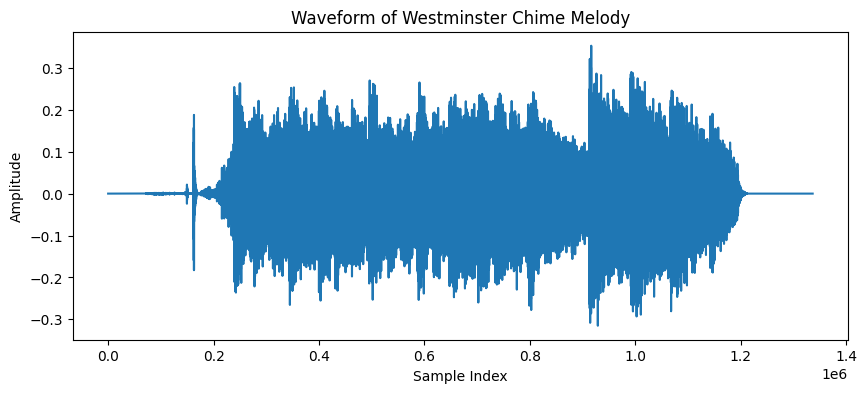

In [10]:
# Load the audio file
file_path = '/content/sample_data/Westminster Chime Melody.mp3'
audio, sr = librosa.load(file_path, sr=None)  # sr=None ensures original sampling rate is used

# Display the waveform
plt.figure(figsize=(10, 4))
plt.plot(audio)
plt.title('Waveform of Westminster Chime Melody')
plt.xlabel('Sample Index')
plt.ylabel('Amplitude')
plt.show()

# Play the audio
ipd.Audio(data=audio, rate=sr)


## Convert the waveform into a spectrogram

A spectrogram is a represents the spectrum of frequencies in a sound over time. It is obtained by applying the [Short-Time Fourier Transform (STFT)](https://en.wikipedia.org/wiki/Short-time_Fourier_transform) to the audio data, which splits the signal into segments and calculates the Fourier transform of each segment. This visualisation shows the magnitude (loudness) of each frequency over time.


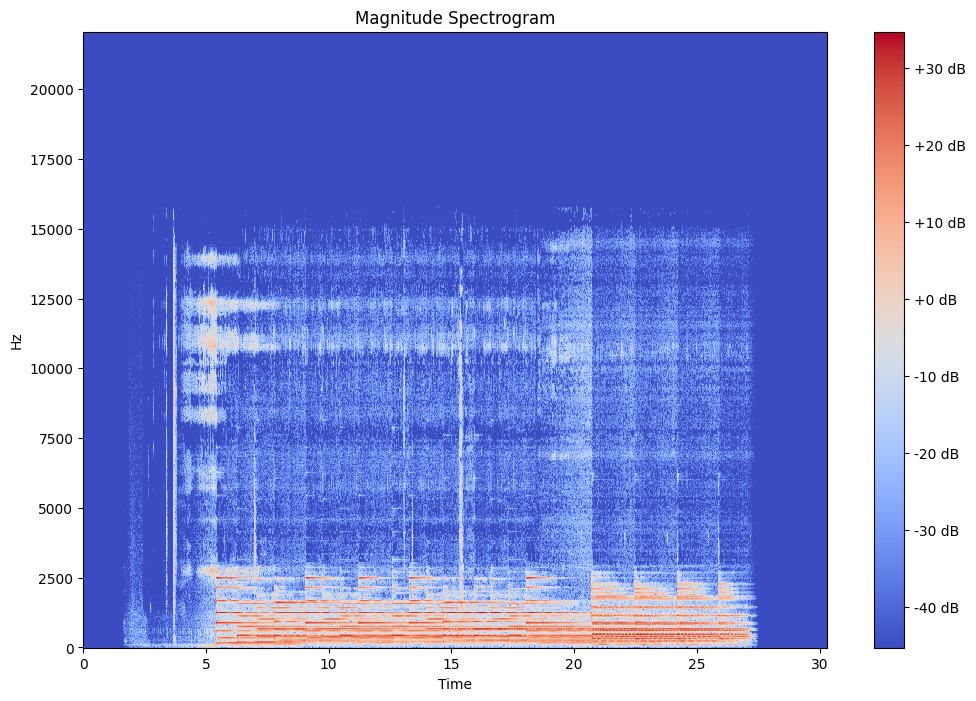

In [11]:
spectrogram = audio_to_spectrogram(audio)
visualize_spectrogram(spectrogram, sr=sr)

## Question 4 [1 point]

Perform PCA on the spectrogram, to get a low-dimensional representation of the frequency content at each timestep.

Reconstruct the audio signal with different #'s of principal components, until you can hear the chimes, but not the mechanical ticking noise.

In [18]:
# spectrogram is an array of shape (num_timesteps, num_frequencies*2).
# You can imagine this matrix as a list of num_timesteps different vectors, each of length num_frequencies*2.
# That is, for each time, there is a vector indicating which sound frequencies are playing.
# You will perform PCA on this set of vectors.
spectrogram.shape
# TODO

(2611, 2050)

In [17]:
from sklearn.decomposition import PCA

def perform_pca_on_spectrogram(spectrogram, num_components):
    pca = PCA(n_components=num_components)
    spectrogram_pca = pca.fit_transform(spectrogram)
    return pca, spectrogram_pca

# Iterating different no of principal components to find the optimal reconstruction
def find_optimal_components(spectrogram, sr, min_components, max_components, increment):
    for num_components in range(min_components, max_components + 1, increment):
        pca, spectrogram_pca = perform_pca_on_spectrogram(spectrogram, num_components)
        spectrogram_reconstructed = pca.inverse_transform(spectrogram_pca)
        audio_reconstructed = spectrogram_to_audio(spectrogram_reconstructed)
        print(f"Reconstructed audio with {num_components} principal components:")
        ipd.display(ipd.Audio(data=audio_reconstructed, rate=sr))


min_components = 5
max_components = 60
increment = 5

find_optimal_components(spectrogram, sr, min_components, max_components, increment)


Reconstructed audio with 5 principal components:


Reconstructed audio with 10 principal components:


Reconstructed audio with 15 principal components:


Reconstructed audio with 20 principal components:


Reconstructed audio with 25 principal components:


Reconstructed audio with 30 principal components:


Reconstructed audio with 35 principal components:


Reconstructed audio with 40 principal components:


Reconstructed audio with 45 principal components:


Reconstructed audio with 50 principal components:


Reconstructed audio with 55 principal components:


Reconstructed audio with 60 principal components:


**Answer:**

Analyzing the reconstructed audio signal with a different number of components, I feel that the chimes are retained and mechanical noise is minimal(not completely emiminated) with the PC's #20. Further decresing below 20 lead to a more compressed representation with less detail. Further Increasing beyond 20 audio signal that retained more detail from the original spectrogram. At 80, almost mechanical noise started appearing.


# Question 5 [2 points]

Plot the spectrogram of your reconstructed signal.

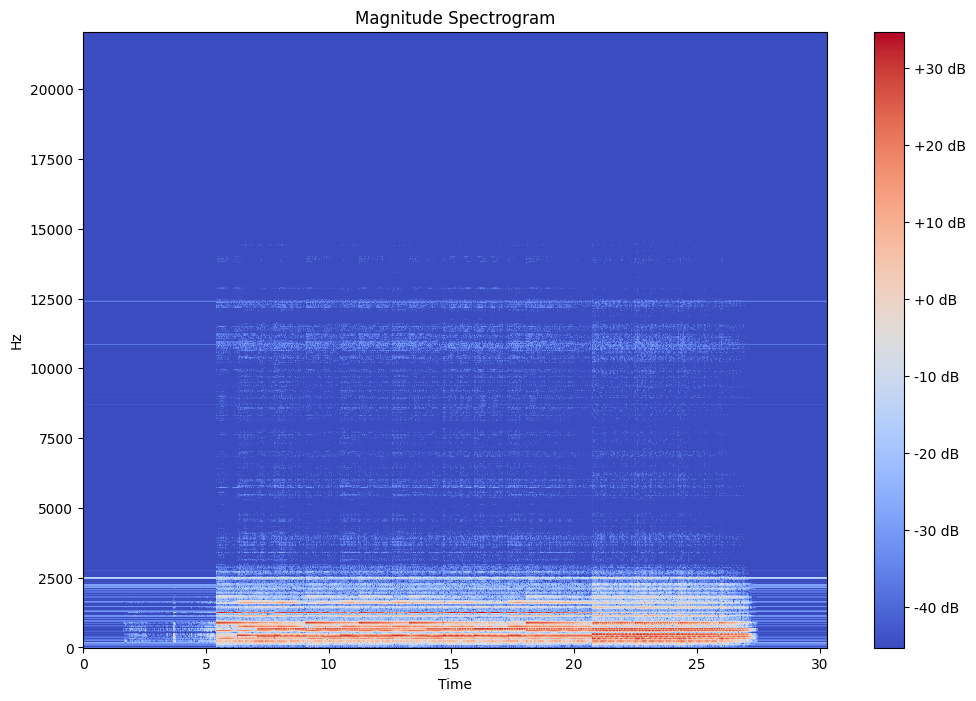

In [21]:
from sklearn.decomposition import PCA

def perform_pca_on_spectrogram(spectrogram, num_components):
    pca = PCA(n_components=num_components)
    spectrogram_pca = pca.fit_transform(spectrogram)
    return pca, spectrogram_pca

#Here the no of pca components: 20
pca, spectrogram_pca = perform_pca_on_spectrogram(spectrogram, 20)
spectrogram_reconstructed = pca.inverse_transform(spectrogram_pca)

# Plot the spectrogram of the reconstructed signal
visualize_spectrogram(spectrogram_reconstructed, sr)


How does it compare to the original spectrogram?

**Answer:**

**Similarities:**

* Both spectrograms cover a similar frequency range, from around 2 kHz to nearly 8 kHz, which is consistent with the high-pitched tones of bells

* The overall vertical structures appear similar across both spectrograms(Original and reconstructed), suggesting that the general location of the musical notes in the frequency domain is preserved after PCA processing.

**Differences:**

* The original spectrogram has more noticeable vertical stripes compared to the reconstructed spectrogram. This suggests that PCA processing have reduced noise.

** Overall Observation:**

The observed differences between the spectrograms are consistent with the expected effects of PCA noise reduction. The ticking noise likely caused the vertical stripes in the original spectrogram, and PCA appears to have mitigated these patterns.

## Question 6 [2 points]

Why does this even work, as a way of eliminating the mechanical background noise??


In your answer, draw a connection between the effect of PCA-based lossy reconstruction of the airplane, and lossy reconstruction of the audio signal.

**Answer:**

PCA works for noise reduction because it separates signal (Chimes music) from noise (Mechanical noise) based on their activity levels in the spectrogram. Mechanical noise like ticking tends to be repetitive and occupies a limited frequency range in the spectrogram. PCA discards components with low variation, which ultimately captures this unchanging noise, leaving the more dynamic musical content.It's like focusing on the busy streets (music) and ignoring the parked cars (noise) in a Mexican City like Cancun.

In both the cases, lossy reconstruction of the airplane and lossy reconstruction od the audio signal it is true that the certain amount of loss is certain. But what we have to consider is what part of this loss is contributing to the meaningful prediction/conclusion towards the end result of the task analysis. In other words, PCA essentially helped in reducing dimensions ignoring or reduces certain components influence and yet capturing the most essential components that is good enough to draw the meaningful conclusions.



## Bonus Question

Using anything you have learned in this class so far, use clustering to identify which note is being played at each time step in the spectrograph.

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


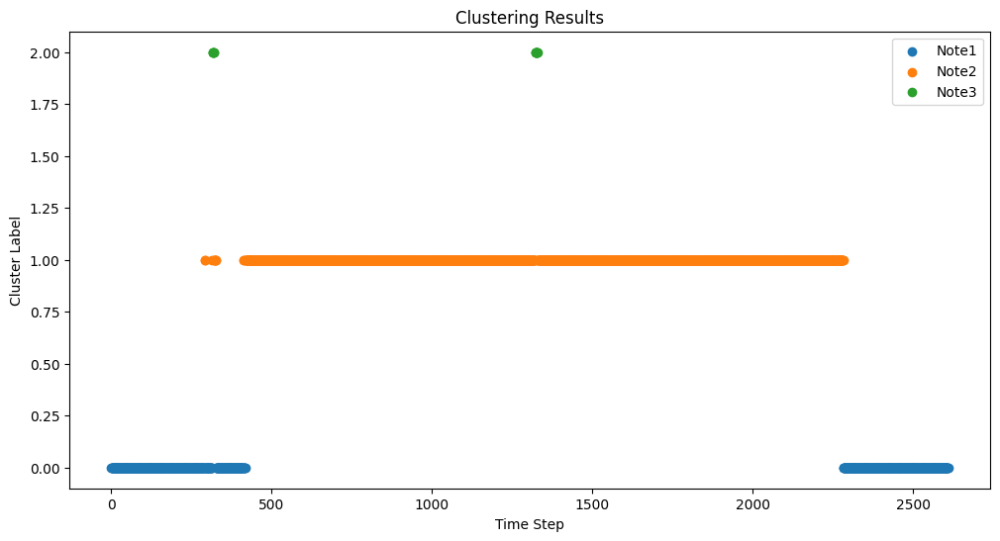

In [28]:
#Using K-Means

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

#Enter the clusters here
num_clusters = 3

features = np.abs(spectrogram)
scaler = StandardScaler()
features_normalized = scaler.fit_transform(features)

kmeans = KMeans(n_clusters=num_clusters)
cluster_labels = kmeans.fit_predict(features_normalized)


cluster_notes = []
for i in range(1,num_clusters+1):
    cluster_notes.append('Note'+ str(i))

plt.figure(figsize=(12, 6))
for cluster_label in range(num_clusters):
    cluster_indices = np.where(cluster_labels == cluster_label)[0]
    plt.scatter(cluster_indices, [cluster_label] * len(cluster_indices), label=cluster_notes[cluster_label])

plt.xlabel('Time Step')
plt.ylabel('Cluster Label')
plt.title('Clustering Results')
plt.legend()
plt.show()
